## Quantifi Lending Club Test

In this notebook you will build out a simple data science workflow to solve a predictive problem.

We have included a dataset, 10K_Lending_Club_Loans.csv. This dataset comes courtesy of Lending Club, an online peer-to-peer lending website that matches those looking to borrow money with those with a little extra to lend out. Lending Club includes a number of descriptive features as well as a target (is_bad) indicating whether the loan was paid back successfully. 

Your task is to:
* Perform a simple exploratory data analysis
* Train a model to predict **is_bad**
* Evaluate accuracy
* **Answer questions about your model**

There is no right or wrong answer, this test is all about showcasing your specific style.

First, the dataset:

In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [2]:
df = pd.read_csv("./10K_Lending_Club_Loans.csv")

In [3]:
df.head(5)

,loan_amnt,funded_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,mths_since_last_major_derog,policy_code,is_bad
0,500,500,36 months,8.07%,15.69,A,A4,NaN,< 1 year,RENT,18000.0,not verified,n,https://www.lendingclub.com/browse/loanDetail....,"I currently live with my parents, study, and w...",other,buying a new computer,112xx,NY,4.27,0.0,11/1/03,0.0,0.0,0.0,4.0,0.0,0,0.0,4.0,f,NaN,1,0
1,500,500,36 months,9.01%,15.91,B,B2,NaN,< 1 year,RENT,2000.0,not verified,n,https://www.lendingclub.com/browse/loanDetail....,I need this loan to help pay for training in a...,other,Loan for Job Training,727xx,AR,0.00,0.0,2/1/07,6.0,0.0,0.0,2.0,0.0,0,0.0,2.0,f,NaN,1,0
2,600,600,36 months,13.24%,20.29,D,D3,Ale House,3 years,RENT,14000.0,not verified,n,https://www.lendingclub.com/browse/loanDetail....,To be used for legal fees,other,Unexpected legal expense,328xx,FL,22.03,0.0,1/1/06,0.0,0.0,0.0,2.0,0.0,195,65.0,3.0,f,NaN,1,0
3,600,600,36 months,11.54%,19.80,C,C5,NaN,< 1 year,RENT,5000.0,not verified,n,https://www.lendingclub.com/browse/loanDetail....,"Hi everyone, I am in desperate need of $500 t...",other,Need to pay rent ASAP!,853xx,AZ,4.80,0.0,10/1/05,3.0,0.0,0.0,4.0,0.0,228,19.0,4.0,f,NaN,1,0
4,900,900,36 months,12.92%,30.29,D,D2,NaN,< 1 year,RENT,12760.0,not verified,n,https://www.lendingclub.com/browse/loanDetail....,Our taxes are a little larger this year so I'd...,debt_consolidation,Pay off Tax Bill,794xx,TX,25.11,0.0,7/1/99,0.0,NaN,NaN,4.0,0.0,3584,50.6,5.0,f,NaN,1,0


In [4]:
df.columns

Index(['loan_amnt', 'funded_amnt', 'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title', 'emp_length', 'home_ownership', 'annual_inc', 'verification_status', 'pymnt_plan', 'url', 'desc', 'purpose', 'title', 'zip_code', 'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'mths_since_last_delinq', 'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'initial_list_status', 'mths_since_last_major_derog', 'policy_code', 'is_bad'], dtype='object')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 34 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   loan_amnt                    10000 non-null  int64  
 1   funded_amnt                  10000 non-null  int64  
 2   term                         10000 non-null  object 
 3   int_rate                     10000 non-null  object 
 4   installment                  10000 non-null  float64
 5   grade                        10000 non-null  object 
 6   sub_grade                    10000 non-null  object 
 7   emp_title                    9408 non-null   object 
 8   emp_length                   9741 non-null   object 
 9   home_ownership               10000 non-null  object 
 10  annual_inc                   9999 non-null   float64
 11  verification_status          10000 non-null  object 
 12  pymnt_plan                   10000 non-null  object 
 13  url              

## Perform exploratory data analysis here:
* Explore a few features visually
* Explore the target output

In [6]:
from pandas_profiling import ProfileReport

In C:\Users\vladi\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\vladi\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\vladi\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In C:\Users\vladi\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In C:\Users\vladi\Anaconda3\lib\site-packages\matplotlib\mpl-data\stylelib\_classic_test.mpl

In [7]:
profile = ProfileReport(df, title="Pandas Profiling Report")

In [8]:
profile

## Clean dataset here
* Remove columns, transform variables, etc

In [9]:
df.head(1)

,loan_amnt,funded_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,mths_since_last_major_derog,policy_code,is_bad
0,500,500,36 months,8.07%,15.69,A,A4,NaN,< 1 year,RENT,18000.0,not verified,n,https://www.lendingclub.com/browse/loanDetail....,"I currently live with my parents, study, and w...",other,buying a new computer,112xx,NY,4.27,0.0,11/1/03,0.0,0.0,0.0,4.0,0.0,0,0.0,4.0,f,NaN,1,0


In [10]:
# underballanced terms
df['term'].value_counts()

36 months    7441
60 months    2559
Name: term, dtype: int64

In [11]:
# remove % and convert to float
df['int_rate'] = df['int_rate'].map(lambda x: float(x.rstrip('%')))

In [12]:
#underbalanced grades
df['grade'].value_counts()

B    2952
A    2449
C    2005
D    1369
E     769
F     327
G     129
Name: grade, dtype: int64

In [13]:
# lots of strings here as a next step 
# i would work on this list to see if they are belonging to some groups or duplicated
# i will drop this column for now

df['emp_title'].value_counts()

US Army                37
Bank of America        23
IBM                    22
USAF                   17
US Navy                17
                       ..
Expressjet Airlines     1
Lulugistics, LLC.       1
freudenberg             1
Division 9 Flooring     1
reliable carbonic       1
Name: emp_title, Length: 8183, dtype: int64

In [14]:
df = df.drop(columns=['emp_title'])

In [15]:
# we've got 259 records with nans I will drop them
df['emp_length'].value_counts().sum()

9741

In [16]:
df = df.dropna(subset = ['emp_length'])

In [17]:
# 1 NONE ownership ==drop
df['home_ownership'].value_counts()
df = df[df['home_ownership']!='NONE']

In [18]:
df['annual_inc'].value_counts()

60000.00    373
50000.00    263
40000.00    220
75000.00    212
30000.00    206
           ... 
20245.00      1
49788.00      1
36396.00      1
68800.00      1
55097.04      1
Name: annual_inc, Length: 1842, dtype: int64

In [19]:
df.shape

(9740, 33)

In [20]:
df['verification_status'].value_counts()

not verified                4257
VERIFIED - income           3108
VERIFIED - income source    2375
Name: verification_status, dtype: int64

In [21]:
# this column is not informative == drop
df['pymnt_plan'].value_counts()

n    9738
y       2
Name: pymnt_plan, dtype: int64

In [22]:
df = df.drop(columns = ['pymnt_plan'])

In [23]:
df.shape

(9740, 32)

In [24]:
# url is not informative - drop
df = df.drop(columns = ['url'])

In [25]:
# desc is not informative now. but i would drill in to see some key words and patterns here. Will delete for now
df = df.drop(columns = ['desc'])

In [26]:
# purpose - OK
df['purpose'].value_counts()

debt_consolidation    4462
credit_card           1260
other                 1008
home_improvement       784
major_purchase         531
small_business         462
car                    340
wedding                250
medical                179
moving                 155
educational            111
house                   92
vacation                88
renewable_energy        18
Name: purpose, dtype: int64

In [27]:
# title is not informative now. but i would drill in to see some key words and patterns here. Will delete for now
df['title'].value_counts()
df = df.drop(columns = ['title'])

In [28]:
#  zip code is potentially usefull as we can get some info on the grouping of the loans and so on.
# I will remove for now as it has too many categories
df['zip_code'].value_counts()
df = df.drop(columns = ['zip_code'])

In [29]:
# addr_state - OK
df['addr_state'].value_counts()

CA    1707
NY     924
FL     691
TX     690
NJ     475
VA     384
IL     376
PA     370
GA     349
MA     321
OH     284
MD     276
WA     210
AZ     200
CT     191
NC     188
CO     173
MI     167
MO     165
MN     133
SC     124
WI     117
AL     114
NV     109
OR     106
KY     101
OK      97
LA      96
UT      67
DC      54
KS      53
RI      52
NH      49
AR      45
NM      43
WV      42
DE      33
HI      32
AK      25
WY      23
MT      23
SD      19
VT      18
MS       9
TN       5
IN       3
NE       3
IA       2
ME       1
ID       1
Name: addr_state, dtype: int64

In [30]:
# dti - OK
df['dti'].value_counts().sum()

9740

In [31]:
# might be usefuil in the future, as we get more data but non informative for now - drop
df['delinq_2yrs'].value_counts()
df = df.drop(columns=['delinq_2yrs'])

In [32]:
#  i would calculate the 'tenure' of the client between today and the date
df['earliest_cr_line'].value_counts()
df['earliest_cr_line'] = df['earliest_cr_line'].apply(lambda x:pd.to_datetime(x))

In [33]:
df['earliest_cr_line_tenure'] = df['earliest_cr_line'].apply(lambda x: (pd.to_datetime("today")- x) / np.timedelta64(1, 'D'))

In [34]:
df['earliest_cr_line_tenure'].head()

0    6128.692546
1    4940.692546
2    5336.692546
3    5428.692546
4    7712.692546
Name: earliest_cr_line_tenure, dtype: float64

In [35]:
# eliminating data with datetime errors
df = df[df['earliest_cr_line_tenure']>0]

In [36]:
df = df.drop(columns=['earliest_cr_line'])

In [37]:
df.head(1)

,loan_amnt,funded_amnt,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,purpose,addr_state,dti,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,mths_since_last_major_derog,policy_code,is_bad,earliest_cr_line_tenure
0,500,500,36 months,8.07,15.69,A,A4,< 1 year,RENT,18000.0,not verified,other,NY,4.27,0.0,0.0,0.0,4.0,0.0,0,0.0,4.0,f,NaN,1,0,6128.692546


In [38]:
# inq_last_6mths - dropped nans
df['inq_last_6mths'] = df['inq_last_6mths'].dropna()
df['inq_last_6mths'].value_counts().sum()

9715

In [39]:
df['mths_since_last_delinq'].unique()

array([  0.,  nan,  63.,  13.,   4.,  78.,  42.,  49.,  26.,  30.,  66.,
        11.,  54.,  17.,  60.,  55.,  68.,  34.,   7.,  71.,  22.,  46.,
        18.,  24.,  72.,  44.,  47.,  67.,   1.,  12.,  29.,  69.,  74.,
        41.,  45.,  62.,  33.,  56.,  59.,  32.,  58.,   9.,   2.,   5.,
        37.,  40.,  57.,  76.,  80.,  35.,  43.,  27.,  16.,  23.,  48.,
        31.,  25.,  19.,  50.,   6.,  52.,  65.,  36.,  81.,  21.,  53.,
         3.,  51.,  39.,  38.,  89.,  79.,  70.,  77.,  28.,  20.,  15.,
         8.,  61.,  14.,  64.,  85.,  82.,  75.,  10.,  96.,  73., 120.,
        83., 115.,  97.,  95.])

In [40]:
df['mths_since_last_delinq'] = df['mths_since_last_delinq'].dropna()
df['mths_since_last_delinq'].value_counts().sum()

3589

In [41]:
# due to the lack of time for this assignment i will drop this column as it is not informative at the moment
# but in future i would improvise with SMOTE in here
df['mths_since_last_delinq'].value_counts()

0.0      163
30.0      66
34.0      65
44.0      64
23.0      63
38.0      63
24.0      62
20.0      62
17.0      60
18.0      60
33.0      59
29.0      59
46.0      58
19.0      58
15.0      57
25.0      57
37.0      56
13.0      56
14.0      56
39.0      54
22.0      53
16.0      52
26.0      52
28.0      51
41.0      51
35.0      51
12.0      50
31.0      49
40.0      49
43.0      48
36.0      48
27.0      48
42.0      47
8.0       47
21.0      47
47.0      47
45.0      46
32.0      46
48.0      46
7.0       45
58.0      43
6.0       43
10.0      41
11.0      41
53.0      40
3.0       40
55.0      40
71.0      39
61.0      39
49.0      38
62.0      38
59.0      36
60.0      36
76.0      36
4.0       35
50.0      35
73.0      33
9.0       32
56.0      32
70.0      32
69.0      31
68.0      30
52.0      29
5.0       29
54.0      29
72.0      29
2.0       28
57.0      28
66.0      28
79.0      27
67.0      26
80.0      26
78.0      25
75.0      25
65.0      24
63.0      24
51.0      24

In [42]:
df = df.drop(columns = ['mths_since_last_delinq'])

In [43]:
df.head(1)

,loan_amnt,funded_amnt,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,purpose,addr_state,dti,inq_last_6mths,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,mths_since_last_major_derog,policy_code,is_bad,earliest_cr_line_tenure
0,500,500,36 months,8.07,15.69,A,A4,< 1 year,RENT,18000.0,not verified,other,NY,4.27,0.0,0.0,4.0,0.0,0,0.0,4.0,f,NaN,1,0,6128.692546


In [44]:
#  mths_since_last_record   non informative - drop
df['mths_since_last_record'].value_counts().sum()

809

In [45]:
df = df.drop(columns=['mths_since_last_record'])

In [46]:
#  open_acc - OK
df['open_acc'].value_counts().sum()

9715

In [47]:
# non informative - drop
df['pub_rec'].value_counts()

0.0    9173
1.0     520
2.0      17
3.0       5
Name: pub_rec, dtype: int64

In [48]:
df = df.drop(columns=['pub_rec'])

In [49]:
# revol_bal - OK
df['revol_bal'].value_counts().sum()

9715

In [50]:
# revol_util - OK
df['revol_util'].value_counts().sum()

9699

In [51]:
# total_acc - OK
df['total_acc'].value_counts().sum()

9715

In [52]:
# non informative - drop
df['initial_list_status'].value_counts()

f    9715
Name: initial_list_status, dtype: int64

In [53]:
df =df.drop(columns=['initial_list_status'])

In [54]:
df = df.drop(columns = ['mths_since_last_major_derog'])

In [55]:
# non informative
df['policy_code'].value_counts()

1    9715
Name: policy_code, dtype: int64

In [56]:
df = df.drop(columns=['policy_code'])

In [57]:
df.shape

(9715, 21)

In [58]:
df = df.dropna()
df.shape

(9699, 21)

In [59]:
df.head(5)

,loan_amnt,funded_amnt,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,purpose,addr_state,dti,inq_last_6mths,open_acc,revol_bal,revol_util,total_acc,is_bad,earliest_cr_line_tenure
0,500,500,36 months,8.07,15.69,A,A4,< 1 year,RENT,18000.0,not verified,other,NY,4.27,0.0,4.0,0,0.0,4.0,0,6128.692546
1,500,500,36 months,9.01,15.91,B,B2,< 1 year,RENT,2000.0,not verified,other,AR,0.00,6.0,2.0,0,0.0,2.0,0,4940.692546
2,600,600,36 months,13.24,20.29,D,D3,3 years,RENT,14000.0,not verified,other,FL,22.03,0.0,2.0,195,65.0,3.0,0,5336.692546
3,600,600,36 months,11.54,19.80,C,C5,< 1 year,RENT,5000.0,not verified,other,AZ,4.80,3.0,4.0,228,19.0,4.0,0,5428.692546
4,900,900,36 months,12.92,30.29,D,D2,< 1 year,RENT,12760.0,not verified,debt_consolidation,TX,25.11,0.0,4.0,3584,50.6,5.0,0,7712.692546


In [60]:
profile = ProfileReport(df, title="Pandas Profiling Report")

In [61]:
profile

In [62]:
# there is a strong correlation between loan amount and funded ammount

In [63]:
df['loan_amnt'].head(5)

0    500
1    500
2    600
3    600
4    900
Name: loan_amnt, dtype: int64

In [64]:
df['funded_amnt'].head(5)

0    500
1    500
2    600
3    600
4    900
Name: funded_amnt, dtype: int64

In [65]:
# I will remove funded ammount for now as it is repeating loan amount
df = df.drop(columns=['funded_amnt'])

In [66]:
# also iinstallemnt is highly correlated to income and loan amount. 
# I would suggest running a stats test like backpropagation to see how important 
# these features are for the target. I will skip this step for now by deleting installment
df = df.drop(columns=['installment'])

In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9699 entries, 0 to 9999
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   loan_amnt                9699 non-null   int64  
 1   term                     9699 non-null   object 
 2   int_rate                 9699 non-null   float64
 3   grade                    9699 non-null   object 
 4   sub_grade                9699 non-null   object 
 5   emp_length               9699 non-null   object 
 6   home_ownership           9699 non-null   object 
 7   annual_inc               9699 non-null   float64
 8   verification_status      9699 non-null   object 
 9   purpose                  9699 non-null   object 
 10  addr_state               9699 non-null   object 
 11  dti                      9699 non-null   float64
 12  inq_last_6mths           9699 non-null   float64
 13  open_acc                 9699 non-null   float64
 14  revol_bal               

### Prep data for modeling - downsample

In [68]:
# Very underballanced dataset i will downsample for now to send to the model
# in the future we can try upsampling or SMOTE
df['is_bad'].value_counts()

0    8462
1    1237
Name: is_bad, dtype: int64

In [69]:
from sklearn.utils import resample
df_majority = df[df.is_bad==0]
df_minority = df[df.is_bad==1]
 
# Downsample majority class
df_majority_downsampled = resample(df_majority, 
                                 replace=False,    # sample without replacement
                                 n_samples=1237,     # to match minority class
                                 random_state=123) # reproducible results
 
# Combine minority class with downsampled majority class
df_downsampled = pd.concat([df_majority_downsampled, df_minority])
 
# Display new class counts
df_downsampled.is_bad.value_counts()

1    1237
0    1237
Name: is_bad, dtype: int64

### Prep data for modeling - onehot encode

In [70]:
df_downsampled.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2474 entries, 6811 to 9999
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   loan_amnt                2474 non-null   int64  
 1   term                     2474 non-null   object 
 2   int_rate                 2474 non-null   float64
 3   grade                    2474 non-null   object 
 4   sub_grade                2474 non-null   object 
 5   emp_length               2474 non-null   object 
 6   home_ownership           2474 non-null   object 
 7   annual_inc               2474 non-null   float64
 8   verification_status      2474 non-null   object 
 9   purpose                  2474 non-null   object 
 10  addr_state               2474 non-null   object 
 11  dti                      2474 non-null   float64
 12  inq_last_6mths           2474 non-null   float64
 13  open_acc                 2474 non-null   float64
 14  revol_bal            

In [71]:
# avoiding multicoliniarity trap we are deleting the firs value in the getdummies
object_columns = df_downsampled.select_dtypes(include=['object']).columns.to_list()
df_for_ml = pd.get_dummies(data=df_downsampled, columns=object_columns, drop_first =True)

In [72]:
df_for_ml.head()

,loan_amnt,int_rate,annual_inc,dti,inq_last_6mths,open_acc,revol_bal,revol_util,total_acc,is_bad,earliest_cr_line_tenure,term_60 months,grade_B,grade_C,grade_D,grade_E,grade_F,grade_G,sub_grade_A2,sub_grade_A3,sub_grade_A4,sub_grade_A5,sub_grade_B1,sub_grade_B2,sub_grade_B3,sub_grade_B4,sub_grade_B5,sub_grade_C1,sub_grade_C2,sub_grade_C3,sub_grade_C4,sub_grade_C5,sub_grade_D1,sub_grade_D2,sub_grade_D3,sub_grade_D4,sub_grade_D5,sub_grade_E1,sub_grade_E2,sub_grade_E3,sub_grade_E4,sub_grade_E5,sub_grade_F1,sub_grade_F2,sub_grade_F3,sub_grade_F4,sub_grade_F5,sub_grade_G1,sub_grade_G2,sub_grade_G3,sub_grade_G4,sub_grade_G5,emp_length_10+ years,emp_length_2 years,emp_length_3 years,emp_length_4 years,emp_length_5 years,emp_length_6 years,emp_length_7 years,emp_length_8 years,emp_length_9 years,emp_length_< 1 year,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,verification_status_VERIFIED - income source,verification_status_not verified,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding,addr_state_AL,addr_state_AR,addr_state_AZ,addr_state_CA,addr_state_CO,addr_state_CT,addr_state_DC,addr_state_DE,addr_state_FL,addr_state_GA,addr_state_HI,addr_state_IA,addr_state_IL,addr_state_KS,addr_state_KY,addr_state_LA,addr_state_MA,addr_state_MD,addr_state_MI,addr_state_MN,addr_state_MO,addr_state_MS,addr_state_MT,addr_state_NC,addr_state_NE,addr_state_NH,addr_state_NJ,addr_state_NM,addr_state_NV,addr_state_NY,addr_state_OH,addr_state_OK,addr_state_OR,addr_state_PA,addr_state_RI,addr_state_SC,addr_state_SD,addr_state_TN,addr_state_TX,addr_state_UT,addr_state_VA,addr_state_VT,addr_state_WA,addr_state_WI,addr_state_WV,addr_state_WY
6811,13000,10.99,40000.0,16.38,0.0,3.0,17430,67.0,7.0,0,11302.692610,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1685,4200,10.37,35000.0,18.31,0.0,4.0,5381,56.1,10.0,0,5854.692559,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2510,5000,15.96,98000.0,14.36,1.0,7.0,7900,66.7,14.0,0,8227.692569,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6193,12000,15.65,48000.0,9.75,0.0,7.0,3620,38.1,10.0,0,7131.692605,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6060,11200,14.65,50000.0,4.97,1.0,6.0,9309,36.4,15.0,0,6463.692603,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0


## Fit a model here and evaluate the accuracy
* Use whatever model or library you want

In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import sklearn
import numpy as np
from sklearn.model_selection import cross_val_score
from copy import deepcopy
from sklearn.metrics import make_scorer
from typing import Dict
from itertools import product
from sklearn.metrics import mean_squared_error
from math import sqrt
import logging
import pathlib
import sys
import argparse
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMRegressor
from lightgbm import LGBMClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

from scipy.stats import pearsonr

In [74]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp

In [75]:
# set a dictionary of the grid search parameters
ridge_param_dist = {'alpha': [1e-5, 1e-2, 0.1, 1, 10, 100],
                    'random_state': [33]
                    }

In [76]:
rf_param_dist = {'n_estimators': [10, 20, 100, 500, 1000],
                 'max_depth': [None, 5, 10, 30],
                 'max_features': ['sqrt', 'log2'],
                 'random_state': [33],
                 }

In [77]:
lgb_param_dist = {'n_estimators': [100, 500, 1000],
                  'num_leaves': [8, 15, 24, 35, 48, 63, 80],
                  'subsample_freq': [0, 1, 2, 5, 10],
                  'subsample': [0.5, 0.7, 0.8, 0.9],
                  'learning_rate': [0.001, 0.005, 0.01, 0.05, 0.1, 0.3, 0.5],
                  'subsample_for_bin': [5, 10, 20, 50, 100],
                  'boosting_type': ['gbdt', 'dart'],
                  'max_depth': [3, 4, 5, 6, 7, 8, 9],
                  'colsample_bytree': [0.5, 0.7, 0.8, 0.9],
                  'reg_alpha': [0, 1e-5, 1e-2, 0.1, 1, 10, 100],
                  'reg_lambda': [0, 1e-5, 1e-2, 0.1, 1, 10, 100],
                  'random_state': [33]
                  }

In [78]:
lgb_param_class_dist = {'n_estimators': [100, 500, 1000],
                  'num_leaves': [8, 15, 24, 35, 48, 63, 80],
                  'bagging_freq': [1, 2, 5, 10],
                  'subsample': [0.5, 0.7, 0.8, 0.9],
                  'learning_rate': [0.001, 0.005, 0.01, 0.05, 0.1, 0.3, 0.5],
                  'subsample_for_bin': [5, 10, 20, 50, 100],
                  'boosting_type': ['gbdt', 'dart','rf'],
                  'max_depth': [3, 4, 5, 6, 7, 8, 9],
                  'colsample_bytree': [0.5, 0.7, 0.8, 0.9],
                  'reg_alpha': [0, 1e-5, 1e-2, 0.1, 1, 10, 100],
                  'reg_lambda': [0, 1e-5, 1e-2, 0.1, 1, 10, 100],
                  'class_weight': [None,'balanced'],
                  'bagging_fraction':[0.5],
                  'random_state': [33]
                  }

In [79]:
estimator_params = {LGBMRegressor(): lgb_param_dist,
                    RandomForestRegressor(): rf_param_dist,
                    Ridge(): ridge_param_dist}

In [80]:
estimator_params_class = {RandomForestClassifier(): rf_param_dist,
                    LGBMClassifier(): lgb_param_class_dist,
                    RidgeClassifier(): ridge_param_dist}

In [81]:
# set logger
log_fmt = '%(asctime)s - %(name)s - %(levelname)s - %(message)s'
logging.basicConfig(level=logging.INFO, format=log_fmt)
logger = logging.getLogger()

In [82]:
# get the path to data folder
from pathlib import Path
__file__ = Path.cwd()

In [83]:
def get_param_list(param_dist: Dict, max_selection: int):
    """
    If the number of parameter combinations <= max_selection, use all parameter
    combinations in the grid. Otherwise use random generated grid to max_selection
    :param param_dist: Hyperparameters in forms of {param_name_1: [list of possible para values],
                                                    param_name_2: [list of possible para values],
                                                    ...}
    :param max_selection: Maximum combinations to randomly select
    """
    max_possible_combinations = len(list(product(*list(param_dist.values()))))
    ans = []
    if max_possible_combinations <= max_selection:  # use all combinations
        keys = []
        vals = []
        for key, val in param_dist.items():
            keys.append(key)
            vals.append(val)
        param_list = product(*vals)
        for param in param_list:
            ans.append({k: v for k, v in list(zip(keys, param))})
    else:  # use random grid
        for _ in range(max_selection):
            ans.append({k: np.random.choice(v) for k, v in param_dist.items()})
    return ans

In [84]:
def cv_suit(estimators, x, y, cv=3, scoring=None, random_state=33):
    """
    For each estimator in estimators, run cross validation. Return the estimator that gives the highest score given
    by mean test_score from cross validation.
    """
    cv_scores = []
    for estimator in estimators:
        scores = cross_val_score(estimator, X=x, y=y, scoring=scoring, cv=cv)
        cv_scores.append(np.mean(scores))
    max_idx = np.argmax(cv_scores)
    return estimators[max_idx]

In [98]:
def main_class(df_orig, train_df, test_df, scoring=mean_squared_error, n_max_param_combinations=30):
    """This function runs gridsearch and selects the best model with best hyper parameters to predict target

    :param use_pca: Specify whether to use PCA
    :param ncomponents: Specify threshold of explained variance
    :param scoring: specify which scorring to use when comparing models
    :param n_max_param_combinations: Specify what would be the upper limit oh hyper parameter combinations to search in
    :param normalize: Specify whether we want to use normalized data frame
    :return: returns predicted target and plots the correlations
    """
    x_train = train_df.drop('is_bad', axis = 1).values.tolist()
    y_train = train_df['is_bad'].values.tolist()
    index = test_df.index
    
    x_test = test_df.drop('is_bad', axis = 1).values.tolist()


    estimators = []
    for estimator in estimator_params_class.keys():
        param_dist = estimator_params_class.get(estimator)
        if param_dist is not None:
            param_list = get_param_list(param_dist, n_max_param_combinations)
            for params in param_list:
                estimators.append(deepcopy(estimator).set_params(**params))
        else:
            estimators.append(estimator)

    scorer = make_scorer(scoring, greater_is_better=False)

    selected_estimator = cv_suit(estimators, x=x_train, y=y_train, scoring=scorer)
    
    logging.info(selected_estimator)
    selected_estimator.fit(x_train, y_train)
    
    
    predicted = selected_estimator.predict(x_test)
    
    predicted = pd.DataFrame(data=np.array(list(zip(predicted))), columns=['predicted'], index=index)
    
    conf_mat = confusion_matrix(y_true=test_df['is_bad'].values.tolist(), y_pred=predicted)
    print('Confusion matrix:\n', conf_mat)

    labels = ['Class 0', 'Class 1']
    n_classes = len(labels)
    fig = plt.figure()
    ax = fig.add_subplot(111)
    cax = ax.matshow(conf_mat, cmap=plt.cm.Blues)
    fig.colorbar(cax)
    ax.set_xticklabels([''] + labels)
    ax.set_yticklabels([''] + labels)
    plt.xlabel('Predicted')
    plt.ylabel('Expected')
    plt.show()
    print (classification_report(test_df['is_bad'].values.tolist(), predicted, target_names=labels))
    
    return selected_estimator

In [99]:
train_df, test_df = train_test_split(df_for_ml, random_state = 33)

C:\Users\vladi\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:148: LinAlgWarning: Ill-conditioned matrix (rcond=2.14928e-18): result may not be accurate.
  overwrite_a=True).T
C:\Users\vladi\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:148: LinAlgWarning: Ill-conditioned matrix (rcond=2.2249e-18): result may not be accurate.
  overwrite_a=True).T
C:\Users\vladi\Anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:148: LinAlgWarning: Ill-conditioned matrix (rcond=3.03856e-18): result may not be accurate.
  overwrite_a=True).T
2020-08-11 16:51:45,511 - root - INFO - RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=5, max_features='log2',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=

Confusion matrix:
 [[191 131]
 [ 94 203]]


C:\Users\vladi\Anaconda3\lib\site-packages\ipykernel_launcher.py:49: UserWarning: FixedFormatter should only be used together with FixedLocator
C:\Users\vladi\Anaconda3\lib\site-packages\ipykernel_launcher.py:50: UserWarning: FixedFormatter should only be used together with FixedLocator


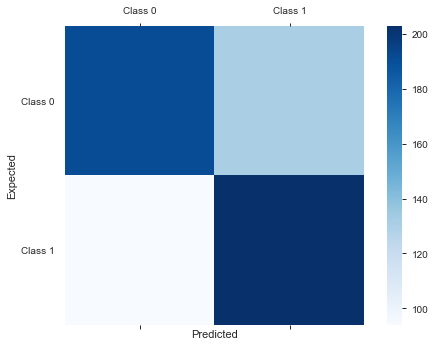

              precision    recall  f1-score   support

     Class 0       0.67      0.59      0.63       322
     Class 1       0.61      0.68      0.64       297

    accuracy                           0.64       619
   macro avg       0.64      0.64      0.64       619
weighted avg       0.64      0.64      0.64       619



In [100]:
selected_estimator = main_class(df_for_ml, train_df, test_df, scoring=mean_squared_error, n_max_param_combinations=10)

Weighted f-1 score is .64 which means that we are predicting a bit better than random guess. We have to work on the model

## Explore your model and answer these questions
You can answer using text, code, or both. 

* **What is the most important feature for your model?**

In [ ]:
print(selected_estimator.feature_importances_) #use inbuilt class feature_importances of tree based classifiers
#plot graph of feature importances for better visualization
feat_importances = pd.Series(selected_estimator.feature_importances_, index=train_df.drop('is_bad', axis = 1).columns)
feat_importances.nlargest(10).plot(kind='barh')
plt.show()

int_rate seems to be the most important feature. We would have to investigate this result

* **Why did you pick this model?**
Historically ridge lgbm, xgboost and Random Forest are the go to when dealing with classifications. I picked three and send through the grid search with 10 combinations and cross validation to make a prediction. If we increase # of combinations we can yield better results

* **What were some of the limitations of your approach?**
Slow processing time and hard to explain the results

* **What would you like to try next?**
I have already suggested some additional steps:
1. emp_title has lots of strings here as a next step i would work on this list to see if they are belonging to some groups or duplicated
2. term is underballanced need to work on data collection
3. desc is not informative now. but i would drill in to see some key words and patterns here
4.  mths_since_last_delinq mneeds improvisation with SMOTE
5. zip code is potentially usefull as we can get some info on the grouping of the loans and so on
6. installemnt is highly correlated to income and loan amount. I would suggest running backpropagation to see how important these features are for the target
7. In terms of modeling there are bunch of approaches we need to try. I can make an MLP that will be learning the relation between the data/playing with learning rate and architecture
8. With proposed models: - run more iterations on grid search, run PCA before the modeling, play with balancing and info gain
9. Get the info on what is going with feature importances in the selected_estimator.feature_importances_ as they look odd


## Conclusion
Save this notebook, it will be your submission. Thank you for participating!

Lots of fun and lots of things to experiment with. THX